In [25]:
import argparse
import os

import numpy
import numpy as np
from config import HabitatChallengeConfigPlugin
from omegaconf import DictConfig

import habitat
from habitat.config.default_structured_configs import register_hydra_plugin
from habitat_baselines.config.default import get_config
import sys
import pandas as pd
import matplotlib.pyplot as plt
from utils import FrameSkip, FrameStack, draw_top_down_map, plot_colortable, rand_cmap
import numba
import random
from moviepy.editor import ImageSequenceClip
import cv2
#!ln -s /data /root/HABITAT_2023/data
#!ln -s /data/scene_datasets/hm3d /data/scene_datasets/hm3d_v0.2

In [2]:
parser = argparse.ArgumentParser()
parser.add_argument(
    "--input-type",
    default="rgbd",
    choices=["blind", "rgb", "depth", "rgbd"],
)
parser.add_argument(
    "--evaluation", type=str, required=True, choices=["local", "remote"]
)
parser.add_argument("--model-path", default="", type=str)
parser.add_argument(
    "--task", required=True, type=str, choices=["objectnav", "imagenav"]
)
parser.add_argument("--task-config", type=str, required=True)
parser.add_argument(
    "--action_space",
    type=str,
    default="velocity_controller",
    choices=[
        "velocity_controller",
        "waypoint_controller",
        "discrete_waypoint_controller",
    ],
    help="Action space to use for the agent",
)
parser.add_argument(
    "overrides",
    default=None,
    nargs=argparse.REMAINDER,
    help="Modify config options from command line",
)


benchmark_config_path =  "configs/benchmark/nav/objectnav/objectnav_v2_hm3d_stretch_challenge.yaml"
args = parser.parse_args('--evaluation local --model-path objectnav_baseline_habitat_navigation_challenge_2023.pth --input-type rgbd --task objectnav --action_space discrete_waypoint_controller --task-config configs/ddppo_objectnav_v2_hm3d_stretch.yaml'.split())

In [3]:
register_hydra_plugin(HabitatChallengeConfigPlugin)

In [4]:
overrides = args.overrides + [
        'habitat_baselines.rl.policy.action_distribution_type=categorical', 
        'habitat_baselines.load_resume_state_config=True',
        "benchmark/nav/" + args.task + "=" + os.path.basename(benchmark_config_path),
        "habitat/task/actions=" + args.action_space,
        #"+my_habitat_scene="+'/data/scene_datasets/habitat-test-scenes/van-gogh-room.glb',
        "+pth_gpu_id=0",
        "+input_type=" + args.input_type,
        "+model_path=" + args.model_path,
        "+random_seed=7",
    ]
#os.environ["CHALLENGE_CONFIG_FILE"] = "configs/benchmark/nav/objectnav/objectnav_v2_hm3d_stretch_challenge.yaml"

In [5]:
config = get_config(
        args.task_config,
        overrides,
    )

In [6]:
from habitat import make_dataset
_dataset = make_dataset(id_dataset=config.habitat.dataset.type, config=config.habitat.dataset)

2023-04-07 04:38:17,041 Initializing dataset ObjectNav-v1


In [7]:
from env_orb_23 import Env
one_env = Env(config=config,dataset=_dataset)

2023-04-07 04:38:17,806 initializing sim Sim-v0
2023-04-07 04:38:24,942 Initializing task ObjectNav-v2


0 /data/scene_datasets/hm3d_v0.2/minival/00802-wcojb4TFT35/wcojb4TFT35.basis.glb
15 /data/scene_datasets/hm3d_v0.2/minival/00800-TEEsavR23oF/TEEsavR23oF.basis.glb
NUMBER OF SCENES  2
NUMBER OF EPS  30


[29.535587]


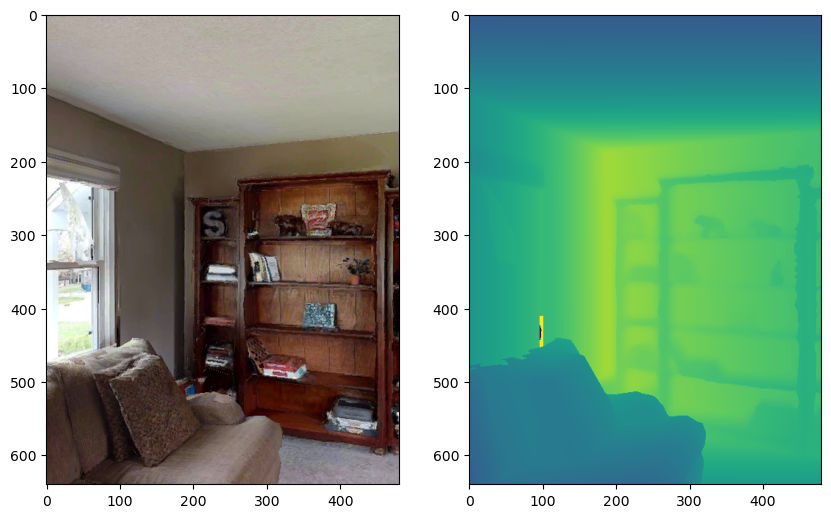

In [8]:
obs = one_env.reset(0); idd = 0
obs, reward, done, info = one_env.step(action=2)
#obs, reward, done, info = one_env.step(action=3)
f = plt.figure(figsize=(10,10))
ax = f.add_subplot(1,2,1)
ax1 = f.add_subplot(1,2,2)
ax.imshow(obs['rgb'])
ax1.imshow(obs['depth'][:,:,0])
print(np.rad2deg(obs['compass']))

[59.071175]


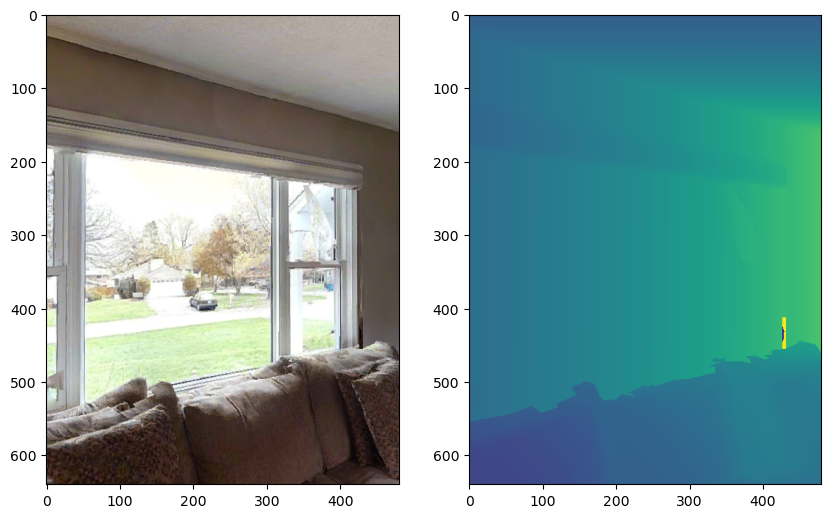

In [9]:
obs = one_env.reset(0); idd = 0
obs, reward, done, info = one_env.step(action=2)
obs, reward, done, info = one_env.step(action=2)
f = plt.figure(figsize=(10,10))
ax = f.add_subplot(1,2,1)
ax1 = f.add_subplot(1,2,2)
ax.imshow(obs['rgb'])
ax1.imshow(obs['depth'][:,:,0])
print(np.rad2deg(obs['compass']))

In [26]:
from habitat.core.agent import Agent
from habitat.core.simulator import Observations
from typing import Dict, Optional
import gym.spaces as spaces
import habitat
from habitat.config.default_structured_configs import register_hydra_plugin
from habitat.core.agent import Agent
from habitat.core.simulator import Observations
from habitat.core.spaces import ActionSpace, EmptySpace
from habitat.gym.gym_wrapper import continuous_vector_action_to_hab_dict
from habitat_baselines.common.baseline_registry import baseline_registry
from habitat_baselines.common.obs_transformers import (
    apply_obs_transforms_batch,
    apply_obs_transforms_obs_space,
    get_active_obs_transforms,
)
from habitat_baselines.config.default import get_config
from habitat_baselines.rl.ddppo.policy import PointNavResNetPolicy
from habitat_baselines.utils.common import (
    batch_obs,
    get_action_space_info,
    get_num_actions,
    is_continuous_action_space,
)
import torch


class PPOAgent(Agent):
    def __init__(self, config: DictConfig) -> None:
        num_object_categories = 6
        image_size = config.habitat_baselines.rl.policy.obs_transforms.center_cropper

        obs_space = {
            "compass": spaces.Box(low=-np.pi, high=np.pi, shape=(1,), dtype=np.float32),
            "gps": spaces.Box(
                low=np.finfo(np.float32).min,
                high=np.finfo(np.float32).max,
                shape=(2,),
                dtype=np.float32,
            ),
            "depth": spaces.Box(
                low=0,
                high=1,
                shape=(image_size.height, image_size.width, 1),
                dtype=np.float32,
            ),
            "rgb": spaces.Box(
                low=0,
                high=255,
                shape=(image_size.height, image_size.width, 3),
                dtype=np.uint8,
            ),
        }

        if config.habitat.task.goal_sensor_uuid == "objectgoal":
            obs_space["objectgoal"] = spaces.Box(
                low=0, high=num_object_categories - 1, shape=(1,), dtype=np.int64
            )
        elif config.habitat.task.goal_sensor_uuid == "instance_imagegoal":
            obs_space["instance_imagegoal"] = spaces.Box(
                low=0,
                high=255,
                shape=(image_size.height, image_size.width, 3),
                dtype=np.uint8,
            )
        obs_space = spaces.Dict(obs_space)

        if config.input_type == "blind":
            del obs_space.spaces["depth"]
            del obs_space.spaces["rgb"]
        elif config.input_type == "depth":
            del obs_space.spaces["rgb"]
        elif config.input_type == "rgb":
            del obs_space.spaces["depth"]

        self.obs_transforms = get_active_obs_transforms(config)
        obs_space = apply_obs_transforms_obs_space(obs_space, self.obs_transforms)

        self.action_space = {}
        self.continuous_actions_high = []
        self.continuous_actions_low = []

        for action in config.habitat.task.actions:
            if action == "velocity_control":
                self.action_space[action] = spaces.Dict(
                    {
                        "linear_velocity": spaces.Box(
                            low=np.array([-1]),
                            high=np.array([1]),
                            dtype=np.float32,
                        ),
                        "angular_velocity": spaces.Box(
                            low=np.array([-1]),
                            high=np.array([1]),
                            dtype=np.float32,
                        ),
                        "camera_pitch_velocity": spaces.Box(
                            low=np.array([-1]),
                            high=np.array([1]),
                            dtype=np.float32,
                        ),
                    }
                )
                self.continuous_actions_high.extend([1, 1])
                self.continuous_actions_low.extend([-1, -1])
            elif action == "waypoint_control":
                self.action_space[action] = spaces.Dict(
                    {
                        "xyt_waypoint": spaces.Box(
                            low=-np.ones(3),
                            high=np.ones(3),
                            dtype=np.float32,
                        ),
                        "delta_camera_pitch_angle": spaces.Box(
                            low=np.array([-1]),
                            high=np.array([1]),
                            dtype=np.float32,
                        ),
                        "max_duration": spaces.Box(
                            low=np.array([0]),
                            high=np.array([1]),
                            dtype=np.float32,
                        ),
                    }
                )
                self.continuous_actions_high.extend([1, 1, 1, 1])
                self.continuous_actions_low.extend([0, -1, -1, -1])
            elif action == "velocity_stop":
                self.action_space[action] = spaces.Dict(
                    {
                        "velocity_stop": spaces.Box(
                            low=np.array([-1]),
                            high=np.array([1]),
                            dtype=np.float32,
                        )
                    }
                )
                self.continuous_actions_high.extend([1])
                self.continuous_actions_low.extend([-1])
            else:
                self.action_space[action] = EmptySpace()
        self.action_space = ActionSpace(self.action_space)

        self.device = (
            torch.device("cuda:{}".format(config.pth_gpu_id))
            if torch.cuda.is_available()
            else torch.device("cpu")
        )
        self.hidden_size = config.habitat_baselines.rl.ppo.hidden_size
        random_generator.seed(config.random_seed)

        if torch.cuda.is_available():
            torch.backends.cudnn.deterministic = True  # type: ignore

        policy = baseline_registry.get_policy(config.habitat_baselines.rl.policy.name)
        
        self.continuous_actions = (
            True
            if config.habitat_baselines.rl.policy.action_distribution_type
            != "categorical"
            else False
        )
        
        if self.continuous_actions:
            self.env_action_space = spaces.Box(
                shape=(get_num_actions(self.action_space),),
                low=np.array(self.continuous_actions_low),
                high=np.array(self.continuous_actions_high),
                dtype=np.float32,
            )
        else:
            self.env_action_space = spaces.Discrete(get_num_actions(self.action_space))

        self.actor_critic = policy.from_config(
            config,
            obs_space,
            self.env_action_space,
            orig_action_space=self.action_space,
        )

        self.actor_critic.to(self.device)

        if config.model_path:
            ckpt = torch.load(config.model_path, map_location=self.device)
            #  Filter only actor_critic weights
            self.actor_critic.load_state_dict(
                {
                    k[len("actor_critic.") :]: v
                    for k, v in ckpt["state_dict"].items()
                    if "actor_critic" in k
                }
            )

        else:
            habitat.logger.error(
                "Model checkpoint wasn't loaded, evaluating a random model."
            )

        policy_action_space = self.actor_critic.get_policy_action_space(
            self.env_action_space
        )
        self.policy_action_space, _ = get_action_space_info(policy_action_space)

        self.test_recurrent_hidden_states: Optional[torch.Tensor] = None
        self.not_done_masks: Optional[torch.Tensor] = None
        self.prev_actions: Optional[torch.Tensor] = None

    def reset(self) -> None:
        self.test_recurrent_hidden_states = torch.zeros(
            1,
            self.actor_critic.num_recurrent_layers,
            self.hidden_size,
            device=self.device,
        )
        self.not_done_masks = torch.zeros(1, 1, device=self.device, dtype=torch.bool)

        self.prev_actions = torch.zeros(
            1,
            *self.policy_action_space,
            dtype=torch.float32 if self.continuous_actions else torch.long,
            device=self.device,
        )

    def act(self, observations: Observations) -> Dict[str, int]:
        sample_random_seed()
        batch = batch_obs([observations], device=self.device)
        batch = apply_obs_transforms_batch(batch, self.obs_transforms)
        with torch.no_grad():
            action_data = self.actor_critic.act(
                batch,
                self.test_recurrent_hidden_states,
                self.prev_actions,
                self.not_done_masks,
                deterministic=False,
            )

            self.test_recurrent_hidden_states = action_data.rnn_hidden_states

            #  Make masks not done till reset (end of episode) will be called
            self.not_done_masks.fill_(True)
            self.prev_actions.copy_(action_data.actions)  # type: ignore
            if self.continuous_actions:
                # Clipping actions to the specified limits
                act = np.clip(
                    action_data.env_actions[0].cpu().numpy(),
                    self.env_action_space.low,
                    self.env_action_space.high,
                )
                step_action = continuous_vector_action_to_hab_dict(
                    self.action_space, None, act
                )
            else:
                step_action = {"action": action_data.env_actions[0].item()}

        return step_action

In [27]:
random_generator = np.random.RandomState()
@numba.njit
def _seed_numba(seed: int):
    random.seed(seed)
    np.random.seed(seed)
def set_random_seed(seed: int):
    random.seed(seed)
    np.random.seed(seed)
    _seed_numba(seed)
    torch.random.manual_seed(seed)
def sample_random_seed():
    set_random_seed(random_generator.randint(2**32))
import io
def get_img_from_fig(fig, dpi=180):
    buf = io.BytesIO()
    fig.savefig(buf, format="png", dpi=dpi)
    buf.seek(0)
    img_arr = np.frombuffer(buf.getvalue(), dtype=np.uint8)
    buf.close()
    img = cv2.imdecode(img_arr, 1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    return img    

agent = PPOAgent(config)

[59.071175]


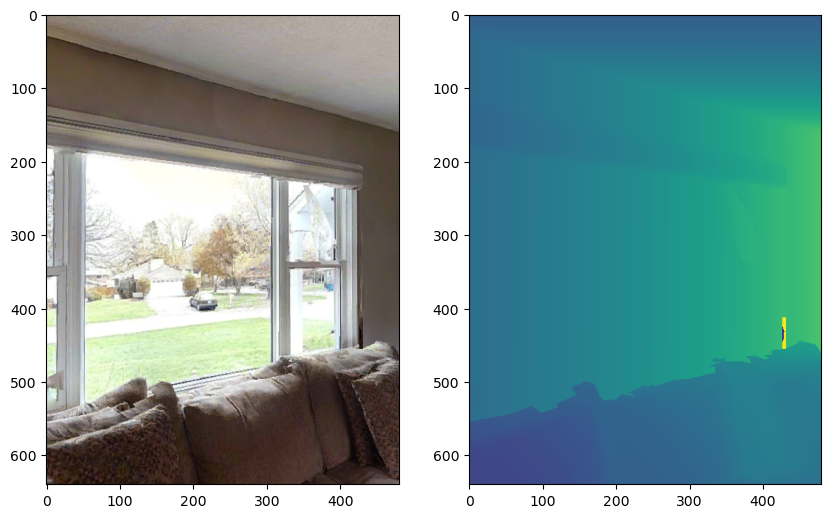

In [28]:
obs = one_env.reset(0); idd = 0
obs, reward, done, info = one_env.step(action=2)
obs, reward, done, info = one_env.step(action=2)
f = plt.figure(figsize=(10,10))
ax = f.add_subplot(1,2,1)
ax1 = f.add_subplot(1,2,2)
ax.imshow(obs['rgb'])
ax1.imshow(obs['depth'][:,:,0])
print(np.rad2deg(obs['compass']))

In [29]:
done = False; frames = []; frames_depth = []
obs = one_env.reset(0); idd = 0
agent.reset()
f = plt.figure(figsize=(10,10))
ax = f.add_subplot(1,2,1)
ax1 = f.add_subplot(1,2,2)
ax.imshow(obs['rgb'])
ax1.imshow(obs['depth'][:,:,0])
iimg = get_img_from_fig(f)
frames.append(iimg)    
plt.close()
while not done:
    action = agent.act(obs)
    obs, reward, done, info = one_env.step(action); idd+=1
    print(idd, action)
    f = plt.figure(figsize=(10,10))
    ax = f.add_subplot(1,2,1)
    ax1 = f.add_subplot(1,2,2)
    ax.imshow(obs['rgb'])
    ax1.imshow(obs['depth'][:,:,0])
    iimg = get_img_from_fig(f)
    frames.append(iimg)    
    plt.close()

1 {'action': 5, 'action_args': {}}
2 {'action': 2, 'action_args': {}}
3 {'action': 5, 'action_args': {}}
4 {'action': 1, 'action_args': {}}
5 {'action': 2, 'action_args': {}}
6 {'action': 5, 'action_args': {}}
7 {'action': 3, 'action_args': {}}
8 {'action': 3, 'action_args': {}}
9 {'action': 4, 'action_args': {}}
10 {'action': 1, 'action_args': {}}
11 {'action': 1, 'action_args': {}}
12 {'action': 2, 'action_args': {}}
13 {'action': 2, 'action_args': {}}
14 {'action': 2, 'action_args': {}}
15 {'action': 1, 'action_args': {}}
16 {'action': 3, 'action_args': {}}
17 {'action': 5, 'action_args': {}}
18 {'action': 3, 'action_args': {}}
19 {'action': 4, 'action_args': {}}
20 {'action': 3, 'action_args': {}}
21 {'action': 3, 'action_args': {}}
22 {'action': 1, 'action_args': {}}
23 {'action': 5, 'action_args': {}}
24 {'action': 4, 'action_args': {}}
25 {'action': 2, 'action_args': {}}
26 {'action': 4, 'action_args': {}}
27 {'action': 1, 'action_args': {}}
28 {'action': 1, 'action_args': {}}
2

In [30]:
frame = ImageSequenceClip(frames, fps=5)
frame.ipython_display(maxduration=500)

Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4
